<a href="https://colab.research.google.com/github/EFCK/EFCK/blob/main/cluster_tree/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install --quiet opencv-contrib-python matplotlib
!pip install --quiet git+https://github.com/cvg/LightGlue.git
!pip install --quiet torch

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 16.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 87.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 96.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 57.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 45.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 20.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 110.0 MB/s e

In [22]:
import cv2
import kagglehub
#from google.colab import drive
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from pathlib import Path
import networkx as nx
import torch
from sklearn.cluster import SpectralClustering
from tqdm.notebook import tqdm
import os
import gc
from collections import defaultdict
import time
import pickle # pickle dosyaları binary olarak kaydediyor, depolamayı azaltmak içi
from pathlib import Path
import math
from itertools import combinations
from lightglue import LightGlue
from networkx.algorithms.tree import maximum_spanning_tree, minimum_spanning_tree
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from PIL import Image
import pathlib
import seaborn as sns
import random

from sklearn.mixture import GaussianMixture
import torch
from collections import deque
from sklearn.cluster import KMeans
from scipy.sparse.linalg import eigsh
from collections import defaultdict
import os
from pathlib import Path
import networkx as nx
import matplotlib.pyplot as plt
from PIL import Image
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import community.community_louvain as community_louvain
import matplotlib.cm as cm
from itertools import islice
from networkx.algorithms.community import girvan_newman
from networkx.algorithms.community.quality import modularity
import numba
from concurrent.futures import ThreadPoolExecutor
import concurrent.futures
from array import array

# device parametresini "cuda" olarak ayarlayın (GPU varsa)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# CPU çekirdek sayısına göre otomatik ayarlama
max_workers = min(32, os.cpu_count() + 4)  # Önerilen formül

# Daha büyük batch'ler GPU belleğini daha iyi kullanabilir
batch_size = 256  # GPU belleğine göre ayarlandı

def get_image_features_and_descriptors(train_image_paths, output_dir, descriptor):

    output_dir = Path(output_dir)
    output_dir.mkdir(exist_ok=True)

    print("wtf")
    # foldername: [path1, path2, ...], foldername: [path1, path2, ...] yapısında
    for folder, img_paths in train_image_paths.items():
        print(f"Processing folder: {folder} ({len(img_paths)} images)")

        features = {}

        for img_path in img_paths:
            img = cv2.imread(str(img_path))
            if img is not None:
                h, w = img.shape[:2]
            else:
                h, w = None, None

            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            kps, desc = descriptor.detectAndCompute(gray, None)

            # Her keypoint'ten [x, y, size, angle, response, octave, class_id] vektörünü çıkarıyoruz
            kps_array = np.array([
                [kp.pt[0], kp.pt[1],
                kp.size,   kp.angle,
                kp.response,
                kp.octave, kp.class_id]
                for kp in kps
            ], dtype=np.float32)

            features[img_path.name] = {
                "image_size": (h, w),
                "keypoints":    kps_array,
                "descriptors":  desc
            }

            print(f"  {img_path.name:25s} → Dims: ({h}, {w}), "
                f"{kps_array.shape[0]:4d} keypoints, "
                f"desc shape: {desc.shape if desc is not None else None}")

        out_file = output_dir / f"{folder}.pkl"
        with open(out_file, "wb") as f:
            pickle.dump(features, f)

        print(f"Saved {folder} features to {out_file}\n")




def plot_image_descriptors(train_images_path, feature_dir):

    for folder, image_paths in train_images_path.items():
        # dosyadan featureları çek (pkl)
        feature_path = feature_dir / f"{folder}.pkl"
        with open(feature_path, "rb") as f:
            current_features = pickle.load(f)

        n_show = 4
        n_cols = 4
        n_rows = math.ceil(n_show / n_cols)
        fig, axes = plt.subplots(n_rows, n_cols,
                                figsize=(4 * n_cols, 4 * n_rows))
        axes = axes.flatten()

        for ax, img_path in zip(axes, image_paths[:n_show]):
            img = cv2.imread(str(img_path))

            # Kaydedilen feature verisini al
            data = current_features[img_path.name]
            desc = data["descriptors"]
            kps = [
                cv2.KeyPoint(
                    pt0,             # x
                    pt1,             # y
                    size * 2,              # çok küçük gözüküyordu size'I 2 kat arttırdım
                    angle,             # angle
                    response,          # response
                    int(octave),       # octave
                    int(class_id)      # class_id
                )
                for (pt0, pt1, size, angle, response, octave, class_id)
                in data["keypoints"]
            ]

            # Keypoint'leri çiz
            out = cv2.drawKeypoints(
                img, kps, None,
                flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
            )
            ax.imshow(cv2.cvtColor(out, cv2.COLOR_BGR2RGB))
            ax.set_title(img_path.name, fontsize=8)
            ax.axis("off")

        for ax in axes[n_show:]:
            ax.axis("off")

        fig.suptitle(f"Folder: {folder} ({n_show} örnek)", fontsize=12)
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        result_path = r"./results/"
        os.makedirs(result_path,exist_ok=True)
        plt.savefig(result_path+"example_images.png")
        plt.show()


import os
import pickle
import random
from pathlib import Path
from concurrent.futures import ThreadPoolExecutor

import cv2
import numpy as np
import torch
from torch.amp import autocast
from lightglue import LightGlue
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from PIL import Image

# Enable cuDNN benchmark mode for optimal performance on fixed input sizes
torch.backends.cudnn.benchmark = True
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# -------------------------------------------------------------------
# 1) Load and JIT-compile the LightGlue matcher once
# -------------------------------------------------------------------
def load_lightglue_matcher(feature_type: str = "sift", device: torch.device = DEVICE, filter_threshold: float = 0.2):
    """
    Initialize LightGlue matcher, set to eval mode, move to GPU, and JIT-compile it.
    """
    print(f"Initializing LightGlue matcher on {device} with feature={feature_type}")
    matcher = LightGlue(
        features=feature_type,
        add_scale_ori=True,
        filter_threshold=filter_threshold
    ).eval().to(device)
    matcher = torch.compile(matcher)
    print("Matcher JIT-compiled and ready.")
    return matcher

# Global matcher instance to avoid repeated initialization
MATCHER = load_lightglue_matcher()

# -------------------------------------------------------------------
# 2) Prepare feature dict into input tensors for LightGlue
# -------------------------------------------------------------------
def _prepare_lg_input(features: dict, device: torch.device = DEVICE) -> dict:
    """
    Convert saved keypoints and descriptors into the tensor format LightGlue expects,
    and push all tensors to the specified device with non_blocking transfers.
    """
    kps = np.asarray(features['keypoints'], dtype=np.float32)
    descs = np.asarray(features['descriptors'], dtype=np.float32)
    descs /= (np.linalg.norm(descs, axis=1, keepdims=True) + 1e-6)

    coords = torch.from_numpy(kps[:, :2]).unsqueeze(0).to(device, non_blocking=True)
    desc_t = torch.from_numpy(descs).unsqueeze(0).to(device, non_blocking=True)
    scales = torch.from_numpy(kps[:, 2]).unsqueeze(0).to(device, non_blocking=True)
    oris = torch.from_numpy(kps[:, 3]).unsqueeze(0).to(device, non_blocking=True)

    h, w = features['image_size']
    img_size = torch.tensor([[h, w]], dtype=torch.float32, device=device)

    return {
        'keypoints': coords,
        'descriptors': desc_t,
        'scales': scales,
        'oris': oris,
        'image_size': img_size
    }

# -------------------------------------------------------------------
# 3) Match a single image pair with mixed precision and no grad
# -------------------------------------------------------------------
@torch.inference_mode()
def match_pair_fast(lg1: dict, lg2: dict, threshold: float = 0.5) -> tuple[float, dict]:
    """
    Compute similarity between two preprocessed LightGlue inputs. Returns a distance-like score and match details.
    """
    # Mixed-precision inference for speed and memory savings
    with autocast("cuda", dtype=torch.float16):
        pred = MATCHER({'image0': lg1, 'image1': lg2})

    m0, s0 = pred['matches0'][0], pred['matching_scores0'][0]
    m1, s1 = pred['matches1'][0], pred['matching_scores1'][0]

    mask0 = (m0 >= 0) & (s0 >= threshold)
    if not mask0.any():
        return float('inf'), {}

    idx0_all = mask0.nonzero(as_tuple=True)[0]
    idx1_all = m0[mask0]

    rec_mask = (m1[idx1_all] == idx0_all) & (s1[idx1_all] >= threshold)
    idx0, idx1 = idx0_all[rec_mask], idx1_all[rec_mask]
    if idx0.numel() == 0:
        return float('inf'), {}

    sc0 = s0[idx0].cpu().numpy()
    sc1 = s1[idx1].cpu().numpy()
    mscores = np.minimum(sc0, sc1)

    good = mscores >= threshold
    score = float(good.sum()) / min(lg1['keypoints'].shape[1], lg2['keypoints'].shape[1])
    similarity = -np.log(score + 1e-6)

    details = {
        'mkpts0': lg1['keypoints'][0, idx0].cpu().numpy(),
        'mkpts1': lg2['keypoints'][0, idx1].cpu().numpy(),
        'mscores': mscores,
        'matches_indices': np.stack([idx0.cpu().numpy(), idx1.cpu().numpy()], axis=1)
    }
    return similarity, details

# -------------------------------------------------------------------
# 4) Batch processing to leverage GPU throughput
# -------------------------------------------------------------------
def process_batch(batch_pairs: list[tuple[str, str]], prepped: dict, threshold: float = 0.5):
    sims, details = [], []
    for u, v in batch_pairs:
        sim, det = match_pair_fast(prepped[u], prepped[v], threshold)
        sims.append(sim)
        details.append(det)
    return sims, details

# -------------------------------------------------------------------
# 5) Build similarity graph in parallel batches
# -------------------------------------------------------------------
def build_image_similarity_graph_parallel(
    data: dict[str, dict],
    threshold: float = 0.5,
    max_workers: int = os.cpu_count(),
    batch_size: int = 32
) -> nx.Graph:
    """
    Create a full pairwise similarity graph by batching GPU workloads and parallelizing CPU tasks.
    Returns a NetworkX graph with edge weight = similarity.
    """
    print("Starting similarity computation...")
    prepped = {name: _prepare_lg_input(feat, DEVICE) for name, feat in data.items()}
    names = list(prepped.keys())
    pairs = [(names[i], names[j]) for i in range(len(names)) for j in range(i+1, len(names))]

    G = nx.Graph()
    G.add_nodes_from(names)

    processed = 0
    total = len(pairs)
    for i in range(0, total, batch_size):
        batch = pairs[i:i+batch_size]
        sims, dets = process_batch(batch, prepped, threshold)
        for (u, v), sim, det in zip(batch, sims, dets):
            G.add_edge(u, v, weight=sim, match_details=det)
        processed += len(batch)
        print(f"Processed pairs: {processed}/{total} ({processed/total*100:.1f}%)")

    print(f"Graph construction complete: {G.number_of_nodes()} nodes, {G.number_of_edges()} edges")
    return G

# -------------------------------------------------------------------
# 6) get_mst: build minimal spanning tree and visualize it
# -------------------------------------------------------------------
def get_mst(
    name: str,
    train_image_paths: dict[str, list[Path]],
    k_factor: float = 1.0,
    device: torch.device = DEVICE,
    FEATURES_TYPE_FOR_LG: str = "sift",
    similarity_function=None,
    threshold: float = 0.5,
    image_zoom: float = 0.05,
    figure_size: tuple[float, float] = (40, 30),
    batch_size=64
) -> tuple[nx.Graph, dict]:
    """
    Load features, build similarity graph, compute MST, and visualize with thumbnails.
    """
    print(f"Loading features for {name}...")
    with open(Path("./features") / f"{name}.pkl", 'rb') as f:
        all_features = pickle.load(f)
    print(f"Loaded features for {len(all_features)} images")

    print("Building similarity graph...")
    G_sim = build_image_similarity_graph_parallel(
        all_features,
        threshold=threshold,
        max_workers=os.cpu_count(),
        batch_size=batch_size
    )

    print("Computing minimum spanning tree...")
    mst = nx.minimum_spanning_tree(G_sim, weight='weight', algorithm='kruskal')
    print(f"MST has {mst.number_of_nodes()} nodes and {mst.number_of_edges()} edges")

    print(f"Computing spring layout with k={k_factor} and iterations=300...")
    pos = nx.spring_layout(mst, k=k_factor, iterations=300, seed=42)
    print("Layout computed")

    print("Creating visualization...")
    fig, ax = plt.subplots(figsize=figure_size)
    nx.draw_networkx_edges(mst, pos, ax=ax, edge_color='gray', width=3.0)

    edge_labels = {(u, v): f"{d['weight']:.2f}" for u, v, d in mst.edges(data=True)}
    if edge_labels:
        nx.draw_networkx_edge_labels(mst, pos, edge_labels=edge_labels, font_size=8, ax=ax)

    print("Adding node images...")
    for i, (node, (x, y)) in enumerate(pos.items()):
        if i % 10 == 0:
            print(f"Processed nodes for visualization: {i}/{len(pos)}")
        img_path = Path(train_image_paths[name][0]).parent / node
        if img_path.exists():
            img = Image.open(img_path)
            ab = AnnotationBbox(OffsetImage(img, zoom=image_zoom), (x, y), frameon=False)
            ax.add_artist(ab)
        else:
            ax.plot(x, y, 'o', markersize=5, color='lightgray')

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect('equal')
    plt.title(f"MST of {name} Similarities")
    plt.tight_layout()

    output_dir = Path("./results") / name
    output_dir.mkdir(parents=True, exist_ok=True)
    plt.savefig(output_dir / "mst.png", dpi=300, bbox_inches='tight')
    print(f"Visualization saved to {output_dir / 'mst.png'}")
    plt.show()

    return mst, pos


def cluster_by_GMM(
    mst: nx.Graph,
    pos: dict,
    train_image_paths: dict,
    name: str,
    min_cluster_size: int = 5,
    figure_size: tuple[float, float] = (40, 30),
    image_zoom: float = 0.14,
    hist_bins: int = 20
):
    """
    1) Plot a histogram of MST edge weights.
    2) Fit a 2-component Gaussian Mixture Model (GMM) to the weights.
       - The component with the higher mean is treated as 'inter-cluster/outlier' edges.
    3) Remove all edges assigned to the high-mean GMM component.
    4) Extract connected components from the pruned graph and classify them
       into 'clusters' (size >= min_cluster_size) and 'outliers'.
    5) Visualize the remaining clusters, highlighting removed edges in red.

    Returns:
        clusters: List of clusters (each a list of node names, size >= min_cluster_size)
        outliers: List of outlier groups (each a list of node names, size < min_cluster_size)
    """
    # --- Prepare output directory ---
    outdir = Path(f"./results/{name}/")
    outdir.mkdir(parents=True, exist_ok=True)

    # --- 1) Plot edge-weight histogram ---
    sim_vals = np.array([d["weight"] for _, _, d in mst.edges(data=True)])
    plt.figure(figsize=(8, 5))
    sns.histplot(sim_vals, bins=hist_bins, edgecolor="black", kde=False)
    plt.title("Histogram of MST Edge Weights")
    plt.xlabel("Edge Weight")
    plt.ylabel("Count")
    plt.tight_layout()
    plt.savefig(outdir / "edge_weight_histogram.png", dpi=300)
    plt.close()

    # --- 2) Fit GMM and identify 'high-mean' component ---
    gmm = GaussianMixture(n_components=2, random_state=0)
    gmm.fit(sim_vals.reshape(-1, 1))
    labels = gmm.predict(sim_vals.reshape(-1, 1))
    means = gmm.means_.flatten()
    # component with larger mean corresponds to inter-cluster/outlier edges
    high_mean_component = int(np.argmax(means))

    # build a list of edges in the same order as sim_vals
    all_edges = list(mst.edges(data=True))
    # select edges to remove
    edges_to_remove = [
        (u, v)
        for (u, v, _), lbl in zip(all_edges, labels)
        if lbl == high_mean_component
    ]

    # --- 3) Prune edges and extract connected components ---
    G_pruned = mst.copy()
    G_pruned.remove_edges_from(edges_to_remove)
    components = [list(c) for c in nx.connected_components(G_pruned)]

    # classify into clusters and outliers
    clusters = [c for c in components if len(c) >= min_cluster_size]
    outliers = [c for c in components if len(c) < min_cluster_size]

    print(f"Detected {len(clusters)} clusters and {len(outliers)} outlier groups.")

    # --- 4) Visualize clusters on the original MST layout ---
    fig, ax = plt.subplots(figsize=figure_size)

    # draw all MST edges in black, removed edges in red
    for u, v in mst.edges():
        color = "red" if ((u, v) in edges_to_remove or (v, u) in edges_to_remove) else "black"
        linewidth = 1.5 if color == "black" else 2.5
        xs, ys = [pos[u][0], pos[v][0]], [pos[u][1], pos[v][1]]
        ax.plot(xs, ys, color=color, linewidth=linewidth, zorder=1)

    # draw node images (or fallback marker) colored by component membership
    # here we color all remaining nodes uniformly; adjust as needed
    for comp in clusters + outliers:
        for node in comp:
            x, y = pos[node]
            img_dir = Path(os.path.dirname(train_image_paths[name][0]))
            img_path = img_dir / node
            if img_path.exists():
                img = Image.open(img_path)
                im = OffsetImage(img, zoom=image_zoom)
                ab = AnnotationBbox(im, (x, y), frameon=False, pad=0.0, zorder=2)
                ax.add_artist(ab)
            else:
                ax.scatter(x, y, s=80, color="gray", zorder=2)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect("equal", adjustable="box")
    plt.title(f"Clusters and Outliers by GMM on MST of {name}")
    plt.tight_layout()
    plt.savefig(outdir / "clusters_gmm.png", dpi=300)
    plt.show()

    return clusters, outliers




def build_image_similarity_chain(
    data: dict[str, dict],
    device: torch.device,
    similarity_good_match_score_threshold: float = 0.5,
    feature_type: str = "sift",
    similarity_function=None,
    max_workers: int = 8
) -> tuple[list[str], dict[tuple[str, str], float]]:
    """
    Optimized greedy chain: start from a random image, then iteratively attach
    the most similar unseen image to either end of the chain.

    This version:
    1. Uses parallel processing to speed up similarity calculations
    2. Caches similarity calculations to avoid redundant computations
    3. Uses a normalized similarity score: sim(a,b) / sum_of_all_similarities
    4. Prints progress information

    Returns:
      - chain: list of image names in order
      - sim_dict: {(u, v): similarity} for each adjacent pair
    """
    if similarity_function is None:
        raise ValueError("similarity_function must be provided")

    img_names = list(data.keys())
    total_images = len(img_names)
    print(f"Building similarity chain for {total_images} images...")

    # Tüm görüntü özelliklerini önceden GPU'ya taşı
    preprocessed_features = {}
    for name, feat in data.items():
        preprocessed_features[name] = _prepare_lg_input(feat, device)

    # Hesaplanan benzerlikleri disk üzerinde önbelleğe alma
    cache_file = f"./cache/similarities_{name}.pkl"
    if os.path.exists(cache_file):
        with open(cache_file, 'rb') as f:
            similarity_cache = pickle.load(f)
    else:
        # Hesapla ve kaydet
        with open(cache_file, 'wb') as f:
            pickle.dump(similarity_cache, f)

    # Generate all pairs of images
    image_pairs = []
    for i, img1 in enumerate(img_names):
        for j in range(i+1, len(img_names)):
            img2 = img_names[j]
            image_pairs.append((img1, img2))

    total_pairs = len(image_pairs)
    print(f"Pre-calculating {total_pairs} similarity pairs in parallel...")

    # Function to compute similarity for a single pair
    def compute_similarity(pair_data):
        idx, (img1, img2) = pair_data
        sim, _ = similarity_function(
            data[img1], data[img2], device,
            similarity_good_match_score_threshold,
            feature_type=feature_type
        )
        return idx, img1, img2, sim

    # Parallel computation of similarities
    processed_count = 0
    total_similarity = 0

    # Process in smaller batches to show more frequent progress updates
    batch_size = 50
    with ThreadPoolExecutor(max_workers=max_workers) as executor:
        # Process image pairs in batches
        for batch_start in range(0, total_pairs, batch_size):
            batch_end = min(batch_start + batch_size, total_pairs)
            batch = [(i, image_pairs[i]) for i in range(batch_start, batch_end)]

            # Submit batch for parallel processing
            future_to_pair = {executor.submit(compute_similarity, pair_data): pair_data for pair_data in batch}

            # Collect results as they complete
            for future in concurrent.futures.as_completed(future_to_pair):
                try:
                    idx, img1, img2, sim = future.result()
                    similarity_cache[(img1, img2)] = similarity_cache[(img2, img1)] = sim
                    total_similarity += sim
                    processed_count += 1

                    # Print progress
                    if processed_count % 10 == 0 or processed_count == total_pairs:
                        print(f"Computing similarities: {processed_count}/{total_pairs} ({processed_count/total_pairs*100:.1f}%)")
                except Exception as e:
                    pair_data = future_to_pair[future]
                    print(f"Error processing pair {pair_data[1]}: {e}")

    if total_similarity == 0:
        print("Warning: Total similarity is zero, using raw similarities instead")
        total_similarity = 1.0  # Avoid division by zero

    print(f"Total similarity sum: {total_similarity:.4f}")

    # Start building the chain
    start = random.choice(img_names)
    chain = deque([start])
    visited = {start}
    sim_dict: dict[tuple[str, str], float] = {}

    print(f"Starting chain with image: {start}")

    # Track progress
    while len(visited) < len(img_names):
        print(f"Chain progress: {len(visited)}/{len(img_names)} images ({len(visited)/len(img_names)*100:.1f}%)")
        best = {'sim': -1.0, 'img': None, 'attach_to': None}

        # evaluate both ends
        for end, side in [(chain[0], 'left'), (chain[-1], 'right')]:
            for img in img_names:
                if img in visited:
                    continue

                # Get cached similarity
                sim = similarity_cache.get((end, img), None)
                if sim is None:
                    # If not in cache (shouldn't happen with pre-calculation)
                    print(f"Warning: Similarity for {end} - {img} not found in cache. Computing now.")
                    sim, _ = similarity_function(
                        data[end], data[img], device,
                        similarity_good_match_score_threshold,
                        feature_type=feature_type
                    )
                    similarity_cache[(end, img)] = similarity_cache[(img, end)] = sim

                # Normalize similarity by total sum
                normalized_sim = sim / total_similarity

                if normalized_sim > best['sim']:
                    best.update({'sim': normalized_sim, 'img': img, 'attach_to': side})

        # attach to chain and record similarity
        if best['img'] is None:
            print("Warning: Could not find a suitable image to add to chain")
            break

        if best['attach_to'] == 'left':
            u, v = best['img'], chain[0]
            chain.appendleft(u)
        else:
            u, v = chain[-1], best['img']
            chain.append(v)
        visited.add(best['img'])
        sim_dict[(u, v)] = best['sim']

        print(f"Added image {best['img']} to {best['attach_to']} with normalized similarity: {best['sim']:.6f}")

    print(f"Chain complete with {len(chain)} images")
    return list(chain), sim_dict


def get_similarity_chain(
    name: str,
    train_image_paths: dict[str, list[str]],
    device: str = "cpu",
    FEATURES_TYPE_FOR_LG: str = "sift",
    similarity_function=None
) -> tuple[nx.Graph, dict[str, tuple[float, float]]]:
    # --- Load features ---
    print(f"Loading features for {name}...")
    features_file = Path(f"./features/{name}.pkl")
    with open(features_file, "rb") as f:
        all_features = pickle.load(f)
    print(f"Loaded features for {len(all_features)} images")

    # --- Build chain and collect similarities ---
    print("Building similarity chain...")
    chain, sim_dict = build_image_similarity_chain(
        all_features, torch.device(device),
        similarity_good_match_score_threshold=0.5,
        feature_type=FEATURES_TYPE_FOR_LG,
        similarity_function=similarity_function
    )

    # Save similarities to disk
    print("Saving similarities to disk...")
    out_dir = Path(f"./results/{name}/")
    out_dir.mkdir(parents=True, exist_ok=True)
    sim_file = out_dir / "chain_similarities.pkl"
    with open(sim_file, 'wb') as sf:
        pickle.dump(sim_dict, sf)

    # Build a path graph with single edges
    print("Building graph...")
    G = nx.Graph()
    G.add_nodes_from(chain)
    for u, v in zip(chain[:-1], chain[1:]):
        sim = sim_dict.get((u, v), sim_dict.get((v, u), 0.0))
        G.add_edge(u, v, weight=sim)

    # Print edges and similarities
    print("Graph edges and weights:")
    for u, v, weight in G.edges(data='weight'):
        print(f"{u} ↔ {v} | sim: {weight:.4f}")

    # --- Visualization parameters ---
    print("Creating visualization...")
    image_zoom = 0.14
    figure_size = (40, 5)
    edge_label_font_size = 15
    edge_label_format = "{:.2f}"
    edge_label_font_color = 'black'

    # Linear layout along x-axis
    pos = {node: (i, 0) for i, node in enumerate(chain)}

    fig, ax = plt.subplots(figsize=figure_size)
    nx.draw_networkx_edges(G, pos, ax=ax, edge_color='gray', width=2.0)
    edge_labels = {(u, v): edge_label_format.format(d)
                   for u, v, d in G.edges(data='weight')}
    if edge_labels:
        nx.draw_networkx_edge_labels(
            G, pos, edge_labels=edge_labels,
            font_size=edge_label_font_size,
            font_color=edge_label_font_color,
            ax=ax
        )

    # Draw nodes as images or dots
    print("Adding images to visualization...")
    node_count = len(pos)
    for i, (node, (x, y)) in enumerate(pos.items()):
        if i % 10 == 0:
            print(f"Processing node images: {i}/{node_count}")

        img_dir = Path(os.path.dirname(train_image_paths[name][0]))
        img_path = img_dir / node
        if img_path.exists():
            img = Image.open(img_path)
            im = OffsetImage(img, zoom=image_zoom)
            ab = AnnotationBbox(im, (x, y), frameon=False, pad=0.0)
            ax.add_artist(ab)
        else:
            ax.plot(x, y, 'o', markersize=max(5, image_zoom * 50),
                    color='lightgray', zorder=1)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect('equal', adjustable='box')
    plt.title(f"Similarity Chain of {name}")
    plt.tight_layout()

    # Save visualization
    print(f"Saving visualization to {out_dir / 'chain.png'}...")
    plt.savefig(out_dir / "chain.png", dpi=300, bbox_inches="tight")
    plt.show()
    print("Chain creation complete.")

    return G, pos


# ----------------- DEPRICATED ---------------

def cluster_by_spectral_clustering(
    mst: nx.Graph,
    pos: dict,
    train_image_paths: dict,
    name: str,
    min_cluster_size: int = 5,
    figure_size: tuple[float, float] = (40, 30),
    image_zoom: float = 0.14,
    max_eigvecs: int = 10
):
    """
    Spectral clustering on the MST:
      1) Build *normalized* Laplacian L from the MST edge-weights.
      2) Compute the first `m` smallest eigenvalues/vectors of L.
      3) Eigengap heuristic → pick k.
      4) k-means on those k eigenvectors.
      5) Split into clusters/outliers, visualize.
    """
    # ensure output dir
    outdir = Path(f"./results/{name}/")
    outdir.mkdir(parents=True, exist_ok=True)

    # 1) Normalized Laplacian directly from NetworkX
    L = nx.normalized_laplacian_matrix(mst, weight='weight')

    # 2) Eigen-decomposition (smallest m eigenvalues/vectors)
    n = mst.number_of_nodes()
    m = min(max_eigvecs, n - 1)
    eigvals, eigvecs = eigsh(L, k=m, which='SM')
    idx = np.argsort(eigvals)
    eigvals, eigvecs = eigvals[idx], eigvecs[:, idx]

    # 3) Eigengap → k
    gaps = np.diff(eigvals)
    k = int(np.argmax(gaps) + 1)
    print(f"Spectral clustering: using k={k} (largest eigengap at {np.argmax(gaps)})")

    # 4) k-means on first k eigenvectors
    embedding = eigvecs[:, :k]
    km = KMeans(n_clusters=k, random_state=42).fit(embedding)
    labels = km.labels_

    # map nodes → labels
    nodes = list(mst.nodes())
    comm_to_nodes = defaultdict(list)
    for i, lab in enumerate(labels):
        comm_to_nodes[lab].append(nodes[i])

    # 5) clusters vs outliers
    clusters = [c for c in comm_to_nodes.values() if len(c) >= min_cluster_size]
    outliers = [c for c in comm_to_nodes.values() if len(c) < min_cluster_size]
    print(f"Found {len(clusters)} clusters (≥{min_cluster_size}) and {len(outliers)} outlier groups")

    # 6) visualize
    fig, ax = plt.subplots(figsize=figure_size)
    cmap = plt.get_cmap("tab20", len(comm_to_nodes))

    for u, v in mst.edges():
        lu = labels[nodes.index(u)]
        lv = labels[nodes.index(v)]
        color = cmap(lu) if lu == lv else "lightgray"
        lw = 2.0 if lu == lv else 1.0
        ax.plot([pos[u][0], pos[v][0]],
                [pos[u][1], pos[v][1]],
                color=color, linewidth=lw, zorder=1)

    for i, node in enumerate(nodes):
        x, y = pos[node]
        color = cmap(labels[i])
        img_dir = Path(os.path.dirname(train_image_paths[name][0]))
        img_path = img_dir / node
        if img_path.exists():
            img = Image.open(img_path)
            im = OffsetImage(img, zoom=image_zoom)
            ab = AnnotationBbox(im, (x, y), frameon=False, pad=0.0, zorder=2)
            ax.add_artist(ab)
        else:
            ax.scatter(x, y, s=100, color=color, zorder=2)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect("equal", "box")
    plt.title(f"Spectral Clustering (k={k}) on MST of {name}")
    plt.tight_layout()
    plt.savefig(outdir / "clusters_spectral.png", dpi=300, bbox_inches="tight")
    plt.show()

    return clusters, outliers



def cluster_by_lowest_weights(
    mst,
    pos,
    train_image_paths,
    name,
    lowest_k=2,
    min_cluster_size=5,
    figure_size=(40, 30),
    image_zoom=0.1,
    hist_bins=20
):
    """
    1) Plot similarity distribution histogram of MST edge weights.
    2) Remove edges whose weight is among the 'lowest_k' distinct smallest weights.
    3) Extract connected components and classify into clusters and outliers.
    4) Visualize the resulting clusters with node images.

    Args:
        mst (nx.Graph): Graph with edge attribute 'weight'.
        pos (dict): Layout dict mapping node -> (x, y).
        train_image_paths (dict): map folder_name -> list of image Paths; node names must match filenames.
        lowest_k (int): number of distinct smallest weight values to remove.
        min_cluster_size (int): threshold for cluster size (>this => cluster).
        figure_size (tuple): figsize for cluster plot.
        image_zoom (float): zoom factor for node images.
        hist_bins (int): number of bins for histogram.
        hist_savepath (str): filepath to save histogram.
        clusters_savepath (str): filepath to save clusters plot.

    Returns:
        clusters (list of lists): each sublist is a cluster of node names.
        outliers (list of lists): each sublist is an outlier group of node names.

    """

    outpath = f"./results/{name}/"
    os.makedirs(outpath, exist_ok=True)

    # --- 1) Similarity distribution histogram ---
    sim_vals = [d['weight'] for _, _, d in mst.edges(data=True)]
    plt.figure(figsize=(10, 6))
    sns.histplot(sim_vals, bins=hist_bins, edgecolor="black", kde=False)
    plt.title("Histogram of Edge Similarities")
    plt.xlabel("Similarity")
    plt.ylabel("Number of Edges")
    plt.tight_layout()
    plt.savefig(outpath+"histogram", dpi=300, bbox_inches="tight")
    plt.show()

    # --- 2) Remove edges with the 'lowest_k' distinct values ---
    unique_weights = sorted(set(sim_vals))
    lowest_vals = set(unique_weights[:lowest_k])
    print(f"Removing edges with the {lowest_k} lowest distinct similarity values: {lowest_vals}")

    edges_to_remove = [
        (u, v)
        for u, v, d in mst.edges(data=True)
        if d['weight'] in lowest_vals
    ]

    G2 = mst.copy()
    G2.remove_edges_from(edges_to_remove)

    # --- 3) Extract connected components and classify ---
    components = [list(c) for c in nx.connected_components(G2)]
    clusters = [c for c in components if len(c) > min_cluster_size]
    outliers = [c for c in components if len(c) <= min_cluster_size]

    print(f"Found {len(clusters)} clusters (size > {min_cluster_size}):")
    for i, comp in enumerate(clusters, 1):
        print(f"  Cluster {i} ({len(comp)} nodes): {comp}")

    print(f"\nFound {len(outliers)} outlier groups (size ≤ {min_cluster_size}):")
    for i, comp in enumerate(outliers, 1):
        print(f"  Outlier {i} ({len(comp)} nodes): {comp}")

    # --- 4) Visualize clusters and removed edges ---
    fig, ax = plt.subplots(figsize=figure_size)

    # draw all edges, highlight removed ones in red
    for u, v in mst.edges():
        color = 'red' if (u, v) in edges_to_remove or (v, u) in edges_to_remove else 'black'
        xs = [pos[u][0], pos[v][0]]
        ys = [pos[u][1], pos[v][1]]
        ax.plot(xs, ys, color=color, linewidth=1)

    # draw images at node positions
    for node, (x, y) in pos.items():
        # assume images path under first folder in train_image_paths
        img_dir = Path(os.path.dirname(train_image_paths[name][0]))
        img_path = img_dir / node
        if img_path.exists():
            img = Image.open(img_path)
            im = OffsetImage(img, zoom=image_zoom)
            ab = AnnotationBbox(im, (x, y), frameon=False, pad=0.0)
            ax.add_artist(ab)
        else:
            ax.scatter(x, y, color='lightgray', s=100, zorder=2)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect('equal', adjustable='box')
    plt.title("Clusters after Removing Lowest Values")
    plt.tight_layout()
    plt.savefig(outpath+"graph", dpi=300, bbox_inches="tight")
    plt.show()

    return clusters, outliers



def cluster_by_louvain(
    mst: nx.Graph,
    pos: dict,
    train_image_paths: dict,
    name: str,
    min_cluster_size: int = 5,
    figure_size: tuple[float, float] = (40, 30),
    image_zoom: float = 0.14,
    resolution: float = 1.0,      # NEW
    level: int | None = None,     # NEW
):
    """
    1) Run Louvain community detection on the MST, using either:
       - a flat partition with `resolution`, or
       - a hierarchical partition at `level`.
    2) Split communities into 'clusters' (size >= min_cluster_size) and 'outliers'.
    3) Plot the MST, coloring edges & nodes by community.
    """
    outdir = Path(f"./results/{name}/")
    outdir.mkdir(parents=True, exist_ok=True)

    # --- 1) Partitioning ---
    if level is None:
        partition = community_louvain.best_partition(
            mst, weight="weight", resolution=resolution
        )
    else:
        dendro = community_louvain.generate_dendrogram(
            mst, weight="weight", resolution=resolution
        )
        partition = community_louvain.partition_at_level(dendro, level)

    # group nodes by community id
    comm_to_nodes: dict[int, list[str]] = {}
    for node, comm in partition.items():
        comm_to_nodes.setdefault(comm, []).append(node)

    # split into clusters vs. outliers
    clusters = [
        nodes for nodes in comm_to_nodes.values()
        if len(nodes) >= min_cluster_size
    ]
    outliers = [
        nodes for nodes in comm_to_nodes.values()
        if len(nodes) < min_cluster_size
    ]

    print(f"resolution={resolution}, level={level} -> "
          f"{len(clusters)} clusters, {len(outliers)} outlier groups")

    # --- 2) Visualization ---
    fig, ax = plt.subplots(figsize=figure_size)
    num_comms = len(comm_to_nodes)
    cmap = cm.get_cmap("tab20", num_comms)

    # draw edges: same-community in color, cross-community in light gray
    for u, v, data in mst.edges(data=True):
        cu, cv = partition[u], partition[v]
        color = cmap(cu) if cu == cv else "lightgray"
        lw = 2.0 if cu == cv else 1.0
        ax.plot(
            [pos[u][0], pos[v][0]],
            [pos[u][1], pos[v][1]],
            color=color,
            linewidth=lw,
            zorder=1
        )

    # draw nodes (images or fallback dots), colored by community
    for node, (x, y) in pos.items():
        comm = partition[node]
        color = cmap(comm)
        img_dir = Path(os.path.dirname(train_image_paths[name][0]))
        img_path = img_dir / node
        if img_path.exists():
            img = Image.open(img_path)
            im = OffsetImage(img, zoom=image_zoom)
            ab = AnnotationBbox(im, (x, y), frameon=False, pad=0.0, zorder=2)
            ax.add_artist(ab)
        else:
            ax.scatter(x, y, s=100, color=color, zorder=2)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect("equal", "box")
    plt.title(f"Louvain Clustering (res={resolution}, lvl={level}) on {name}")
    plt.tight_layout()
    plt.savefig(outdir / "clusters_louvain.png", dpi=300, bbox_inches="tight")
    plt.show()

    return clusters, outliers


def cluster_by_girvan_newman(
    mst: nx.Graph,
    pos: dict,
    train_image_paths: dict,
    name: str,
    min_cluster_size: int = 5,
    figure_size: tuple[float, float] = (40, 30),
    image_zoom: float = 0.14,
    max_iter: int = 10
):
    """
    1) Run Girvan–Newman up to max_iter splits.
    2) At each split compute modularity; pick the partition with highest modularity.
    3) From that best partition, split into 'clusters' (size ≥ min_cluster_size) and 'outliers'.
    4) Visualize the MST colored by those communities.
    """
    outdir = Path(f"./results/{name}/")
    outdir.mkdir(parents=True, exist_ok=True)

    # --- 1) Generate candidate partitions (no weight arg here) ---
    comp_gen = girvan_newman(mst)
    best_mod = -1.0
    best_partition = None

    for communities in islice(comp_gen, max_iter):
        parts = [list(c) for c in communities]
        m = modularity(mst, parts, weight="weight")
        if m > best_mod:
            best_mod = m
            best_partition = parts

    if best_partition is None:
        best_partition = [list(mst.nodes())]
        best_mod = modularity(mst, best_partition, weight="weight")

    print(f"Girvan–Newman: best modularity={best_mod:.4f} with {len(best_partition)} groups")

    # --- 2) Split into clusters vs outliers ---
    clusters = [c for c in best_partition if len(c) >= min_cluster_size]
    outliers = [c for c in best_partition if len(c) <  min_cluster_size]
    print(f"Found {len(clusters)} clusters (≥{min_cluster_size} nodes) and {len(outliers)} outlier groups")

    # --- 3) Visualization ---
    fig, ax = plt.subplots(figsize=figure_size)
    cmap = cm.get_cmap("tab20", len(best_partition))

    # map node -> community
    node2comm = {node: idx for idx, comm in enumerate(best_partition) for node in comm}

    # draw edges
    for u, v in mst.edges():
        cu, cv = node2comm[u], node2comm[v]
        color = cmap(cu) if cu == cv else "lightgray"
        lw = 2.0 if cu == cv else 1.0
        ax.plot([pos[u][0], pos[v][0]],
                [pos[u][1], pos[v][1]],
                color=color, linewidth=lw, zorder=1)

    # draw nodes
    for node, (x, y) in pos.items():
        comm_idx = node2comm[node]
        color = cmap(comm_idx)
        img_dir = Path(os.path.dirname(train_image_paths[name][0]))
        img_path = img_dir / node
        if img_path.exists():
            img = Image.open(img_path)
            im = OffsetImage(img, zoom=image_zoom)
            ab = AnnotationBbox(im, (x, y), frameon=False, pad=0.0, zorder=2)
            ax.add_artist(ab)
        else:
            ax.scatter(x, y, s=100, color=color, zorder=2)

    ax.set_xticks([]); ax.set_yticks([])
    ax.set_aspect("equal", "box")
    plt.title(f"Girvan–Newman Clustering (mod={best_mod:.2f}) on {name}")
    plt.tight_layout()
    plt.savefig(outdir / "clusters_gn.png", dpi=300, bbox_inches="tight")
    plt.show()

    return clusters, outliers


@numba.jit(nopython=True)
def _compute_similarity_score(good_matches, n1, n2):
    score = float(good_matches) / min(float(n1), float(n2))
    return -np.log(score + 1e-6)  # avoid log(0)


def process_batch_true(batch_pairs, preprocessed_data, device, threshold):
    # Batch'leri hazırla ve tek seferde işle
    batch0 = torch.cat([preprocessed_data[img1]['descriptors'] for img1, _ in batch_pairs], dim=0)
    batch1 = torch.cat([preprocessed_data[img2]['descriptors'] for _, img2 in batch_pairs], dim=0)

    # Tek seferde eşleştir
    results = batch_matcher(batch0, batch1, threshold)
    return results




Initializing LightGlue matcher on cuda with feature=sift
Matcher JIT-compiled and ready.


In [3]:
import kagglehub

from google.colab import drive
drive.mount('/content/drive')
#9f52aef6da246db05a5459cc3fcba9dc
kagglehub.login()

Mounted at /content/drive


Kaggle credentials set.
Kaggle credentials successfully validated.


In [4]:
# datasetin pathine ulaşmak için çalıştır
image_matching_challenge_2025_path = kagglehub.competition_download('image-matching-challenge-2025')
image_matching_challenge_2025_path
print('Data source import complete.')

100%|██████████| 4.84G/4.84G [00:23<00:00, 219MB/s]

Extracting files...


Data source import complete.


In [5]:
%cd /content/drive/Othercomputers/My_Laptop/CV_Project/cluster_tree
#from functions import *
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
%matplotlib inline

/content/drive/Othercomputers/My_Laptop/CV_Project/cluster_tree


In [6]:
train_dir = Path(image_matching_challenge_2025_path) / "train"

# {"ETs":[im1path,im2path]} gibi kaydedilecek
train_image_paths = {
    class_folder.name: sorted(class_folder.rglob("*.png"))
    for class_folder in train_dir.iterdir()
    if class_folder.is_dir()
}

print(train_image_paths["ETs"])

[PosixPath('/root/.cache/kagglehub/competitions/image-matching-challenge-2025/train/ETs/another_et_another_et001.png'), PosixPath('/root/.cache/kagglehub/competitions/image-matching-challenge-2025/train/ETs/another_et_another_et002.png'), PosixPath('/root/.cache/kagglehub/competitions/image-matching-challenge-2025/train/ETs/another_et_another_et003.png'), PosixPath('/root/.cache/kagglehub/competitions/image-matching-challenge-2025/train/ETs/another_et_another_et004.png'), PosixPath('/root/.cache/kagglehub/competitions/image-matching-challenge-2025/train/ETs/another_et_another_et005.png'), PosixPath('/root/.cache/kagglehub/competitions/image-matching-challenge-2025/train/ETs/another_et_another_et006.png'), PosixPath('/root/.cache/kagglehub/competitions/image-matching-challenge-2025/train/ETs/another_et_another_et007.png'), PosixPath('/root/.cache/kagglehub/competitions/image-matching-challenge-2025/train/ETs/another_et_another_et008.png'), PosixPath('/root/.cache/kagglehub/competitions/

In [7]:
train_image_paths.keys()
# bunlar path isimleri ileride kullanıcaz

dict_keys(['amy_gardens', 'imc2023_theather_imc2024_church', 'imc2024_dioscuri_baalshamin', 'pt_piazzasanmarco_grandplace', 'ETs', 'pt_brandenburg_british_buckingham', 'imc2023_heritage', 'imc2023_haiper', 'pt_sacrecoeur_trevi_tajmahal', 'stairs', 'imc2024_lizard_pond', 'pt_stpeters_stpauls', 'fbk_vineyard'])

In [ ]:
# bu satırı sadece 1 defa runlasanız yeter -> 20 dk sürüyor

sift = cv2.SIFT_create(nfeatures=4096) # 4096 yı değiştirebiliriz
get_image_features_and_descriptors(train_image_paths, r"./features", sift)

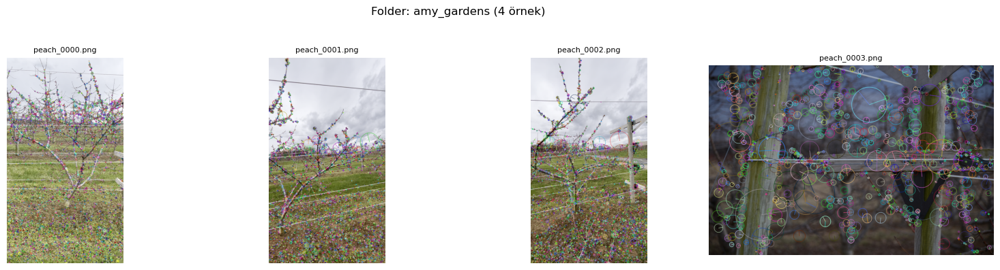

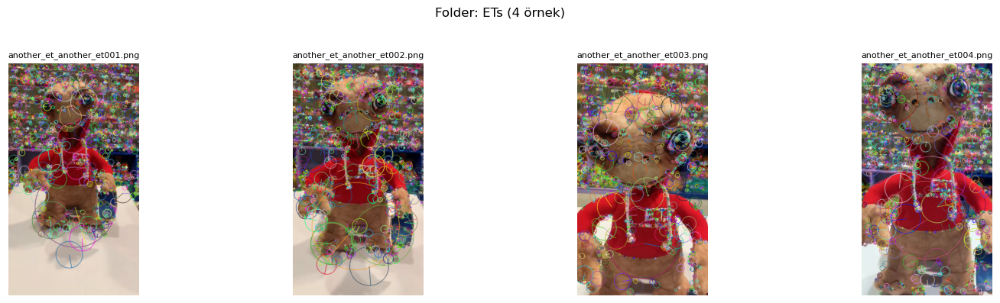

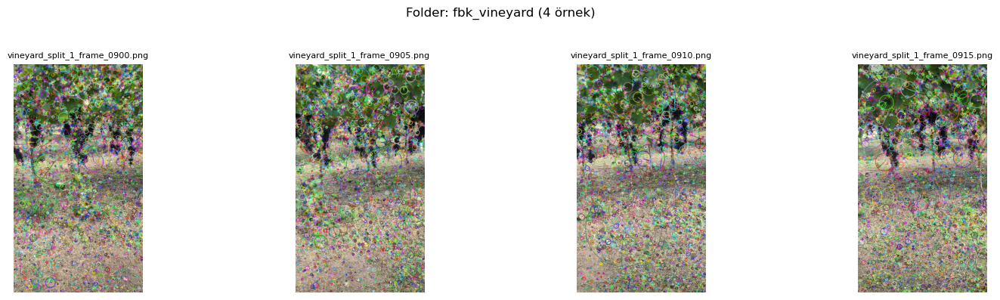

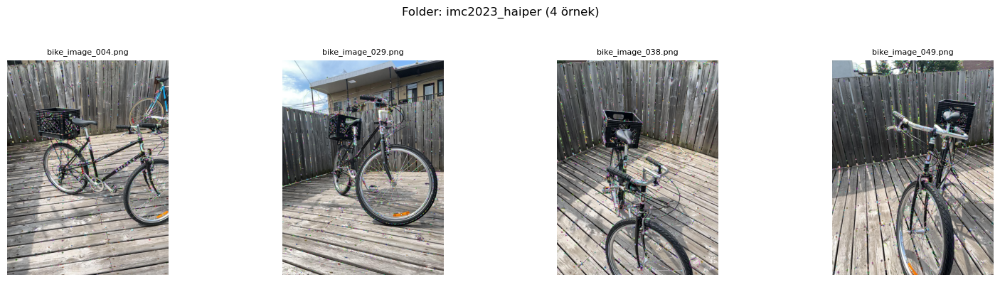

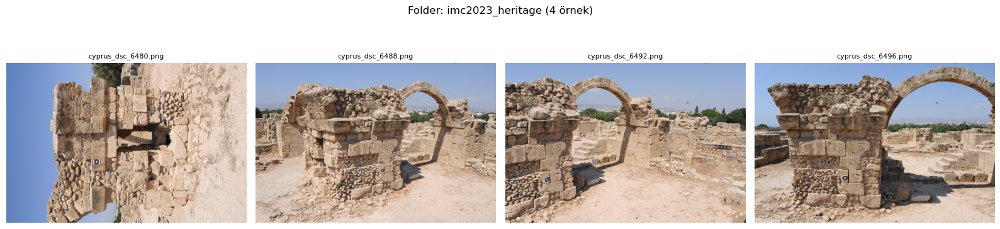

...

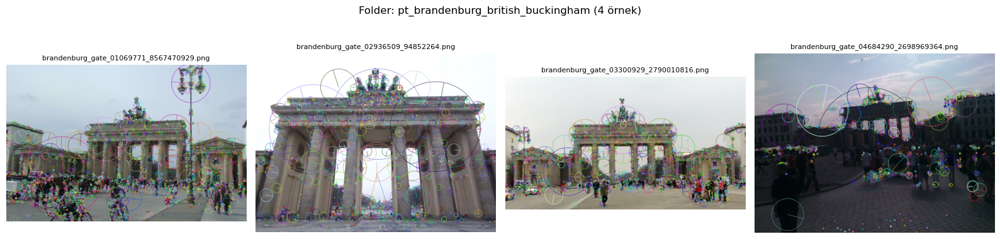

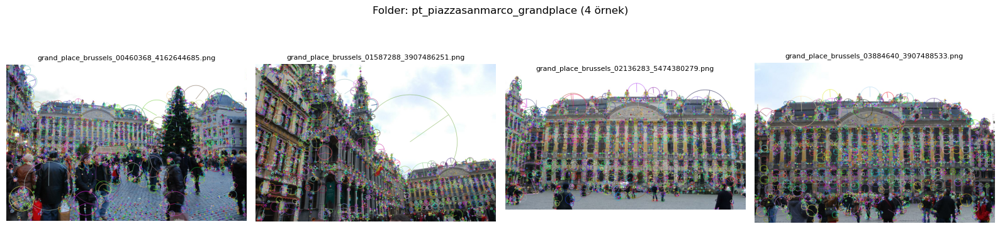

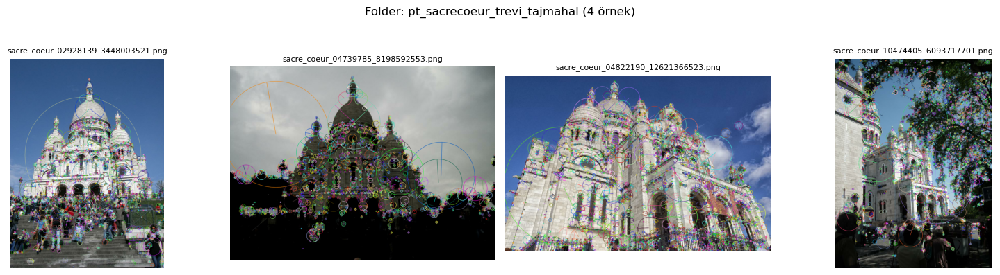

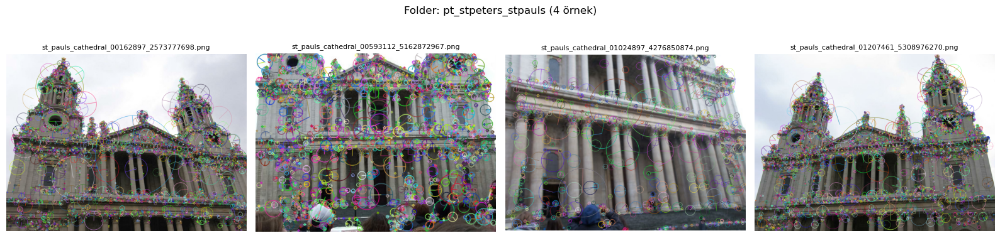

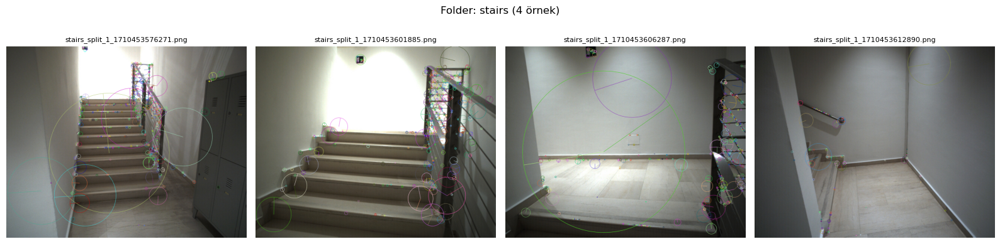

In [ ]:
PICKLE_FILE_PATH = Path("./features")
plot_image_descriptors(train_image_paths, PICKLE_FILE_PATH)

In [8]:
DESCRIPTOR_DIM = 128 # SIFT ile uyumluysa
FEATURES_TYPE_FOR_LG = "sift"
SIMILARITY_THRESHOLD = 0.0001

In [9]:
# file names
with open("./features/ETs.pkl", "rb") as f:
    data = pickle.load(f)

data.keys()
# data bu şekilde geliyor, her bir dosya isminin altında size, keypoint ve descriptors bilgisi var

dict_keys(['another_et_another_et001.png', 'another_et_another_et002.png', 'another_et_another_et003.png', 'another_et_another_et004.png', 'another_et_another_et005.png', 'another_et_another_et006.png', 'another_et_another_et007.png', 'another_et_another_et008.png', 'another_et_another_et009.png', 'another_et_another_et010.png', 'et_et000.png', 'et_et001.png', 'et_et002.png', 'et_et003.png', 'et_et004.png', 'et_et005.png', 'et_et006.png', 'et_et007.png', 'et_et008.png', 'outliers_out_et001.png', 'outliers_out_et002.png', 'outliers_out_et003.png'])

In [10]:
data['another_et_another_et001.png'].keys()
# dict_keys(['image_size', 'keypoints', 'descriptors'])

dict_keys(['image_size', 'keypoints', 'descriptors'])

Loading features for ETs...
Loaded features for 22 images
Building similarity graph...
Starting similarity computation...
Processed pairs: 64/231 (27.7%)
Processed pairs: 128/231 (55.4%)
Processed pairs: 192/231 (83.1%)
Processed pairs: 231/231 (100.0%)
Graph construction complete: 22 nodes, 231 edges
Computing minimum spanning tree...
MST has 22 nodes and 21 edges
Computing spring layout with k=1.0 and iterations=300...
Layout computed
Creating visualization...
Adding node images...
Processed nodes for visualization: 0/22
Processed nodes for visualization: 10/22
Processed nodes for visualization: 20/22
Visualization saved to results/ETs/mst.png


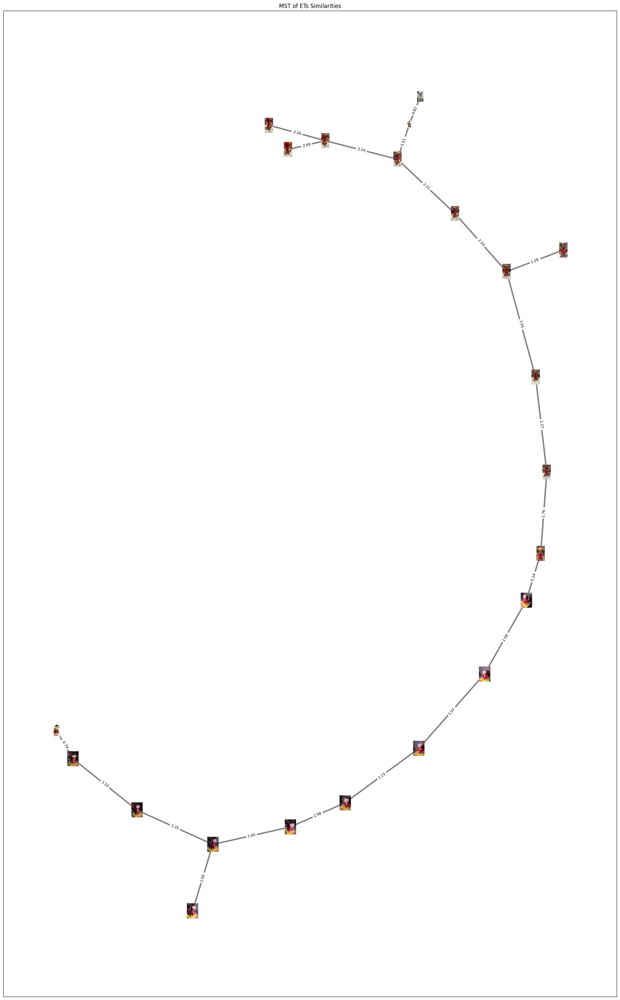

In [23]:
# k factor resimlerin dizilişini ayarlıyorc
mst, pos = get_mst("ETs", train_image_paths=train_image_paths, k_factor=1.0, device = device, FEATURES_TYPE_FOR_LG=FEATURES_TYPE_FOR_LG,threshold=0.5, batch_size=64)


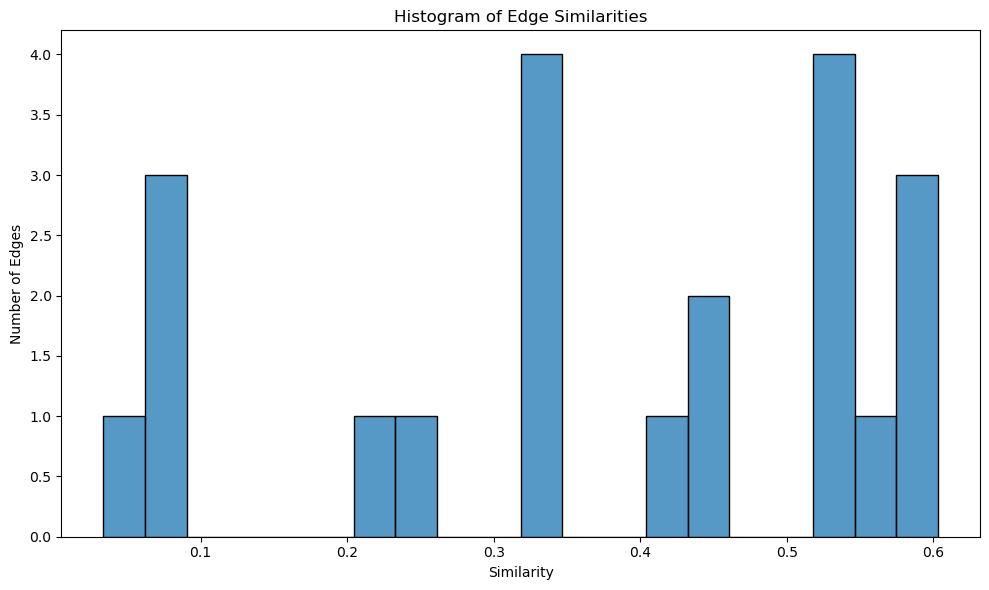

Removing edges with the 2 lowest distinct similarity values: {np.float64(0.03344500310453256), np.float64(0.06362847629757777)}
Found 1 clusters (size > 5):
  Cluster 1 (19 nodes): ['another_et_another_et008.png', 'et_et008.png', 'another_et_another_et001.png', 'another_et_another_et009.png', 'et_et002.png', 'et_et004.png', 'et_et007.png', 'et_et006.png', 'another_et_another_et010.png', 'another_et_another_et006.png', 'et_et001.png', 'et_et003.png', 'another_et_another_et005.png', 'another_et_another_et003.png', 'et_et000.png', 'another_et_another_et002.png', 'another_et_another_et007.png', 'et_et005.png', 'another_et_another_et004.png']

Found 3 outlier groups (size ≤ 5):
  Outlier 1 (1 nodes): ['outliers_out_et001.png']
  Outlier 2 (1 nodes): ['outliers_out_et002.png']
  Outlier 3 (1 nodes): ['outliers_out_et003.png']


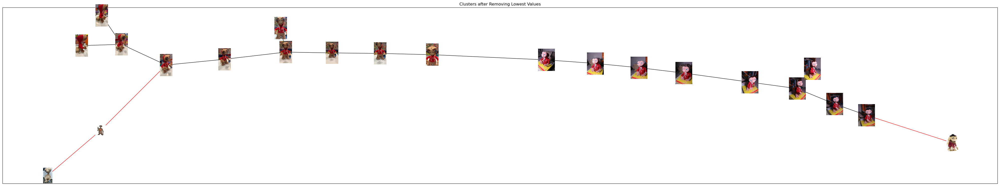

([['another_et_another_et008.png',
   'et_et008.png',
   'another_et_another_et001.png',
   'another_et_another_et009.png',
   'et_et002.png',
   'et_et004.png',
   'et_et007.png',
   'et_et006.png',
   'another_et_another_et010.png',
   'another_et_another_et006.png',
   'et_et001.png',
   'et_et003.png',
   'another_et_another_et005.png',
   'another_et_another_et003.png',
   'et_et000.png',
   'another_et_another_et002.png',
   'another_et_another_et007.png',
   'et_et005.png',
   'another_et_another_et004.png']],
 [['outliers_out_et001.png'],
  ['outliers_out_et002.png'],
  ['outliers_out_et003.png']])

In [ ]:
cluster_by_lowest_weights(mst,pos, train_image_paths, "ETs")

resolution=0.5, level=None -> 1 clusters, 6 outlier groups


C:\Users\krbyk\AppData\Local\Temp\ipykernel_20592\1118417122.py:565: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("tab20", num_comms)


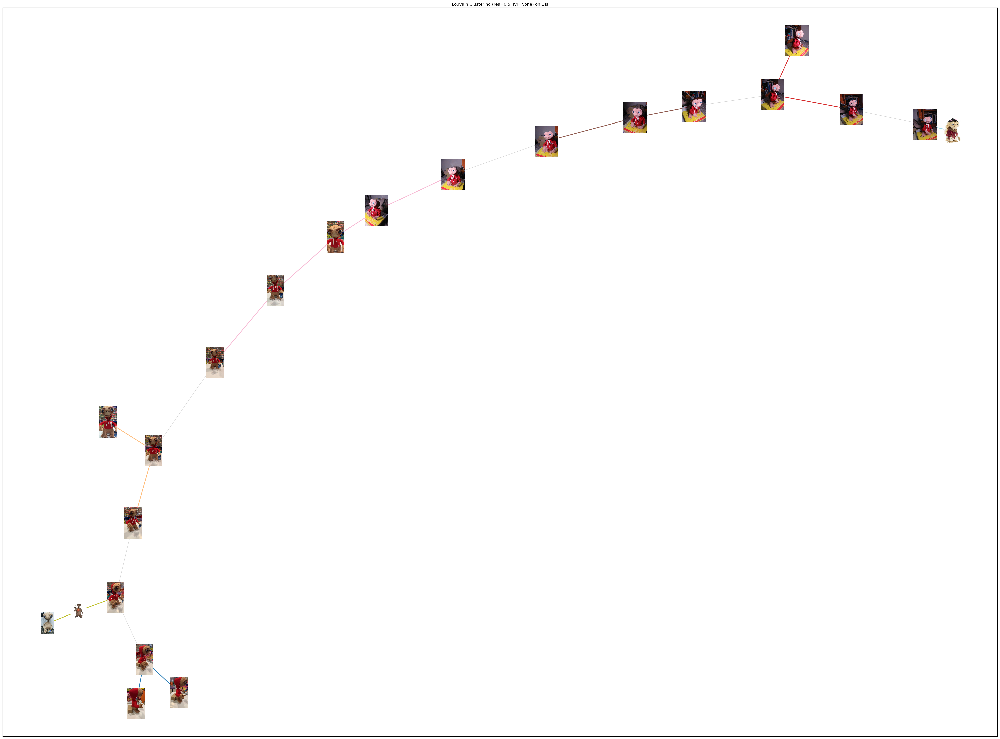

In [ ]:
clusters, outliers = cluster_by_louvain(
    mst, pos, train_image_paths, name="ETs",
    min_cluster_size=5,
    resolution=0.5,
)


Girvan–Newman: best modularity=0.6454 with 6 groups
Found 2 clusters (≥5 nodes) and 4 outlier groups


C:\Users\krbyk\AppData\Local\Temp\ipykernel_20592\1118417122.py:660: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("tab20", len(best_partition))


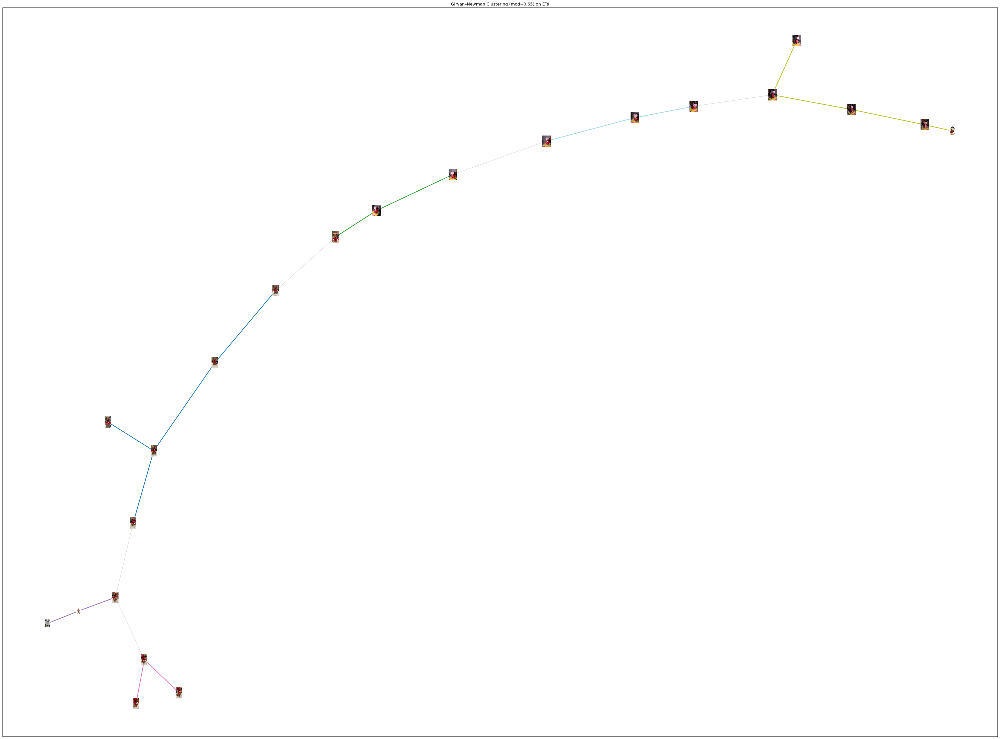

In [ ]:
clusters, outliers = cluster_by_girvan_newman(
    mst,
    pos,
    train_image_paths,
    name="ETs",
    min_cluster_size=5,
    image_zoom=0.05,
    max_iter=10
)


Spectral clustering: using k=8 (largest eigengap at 7)
Found 0 clusters (≥5) and 8 outlier groups


c:\Users\krbyk\miniconda3\envs\cv\lib\site-packages\sklearn\cluster\_kmeans.py:1419: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


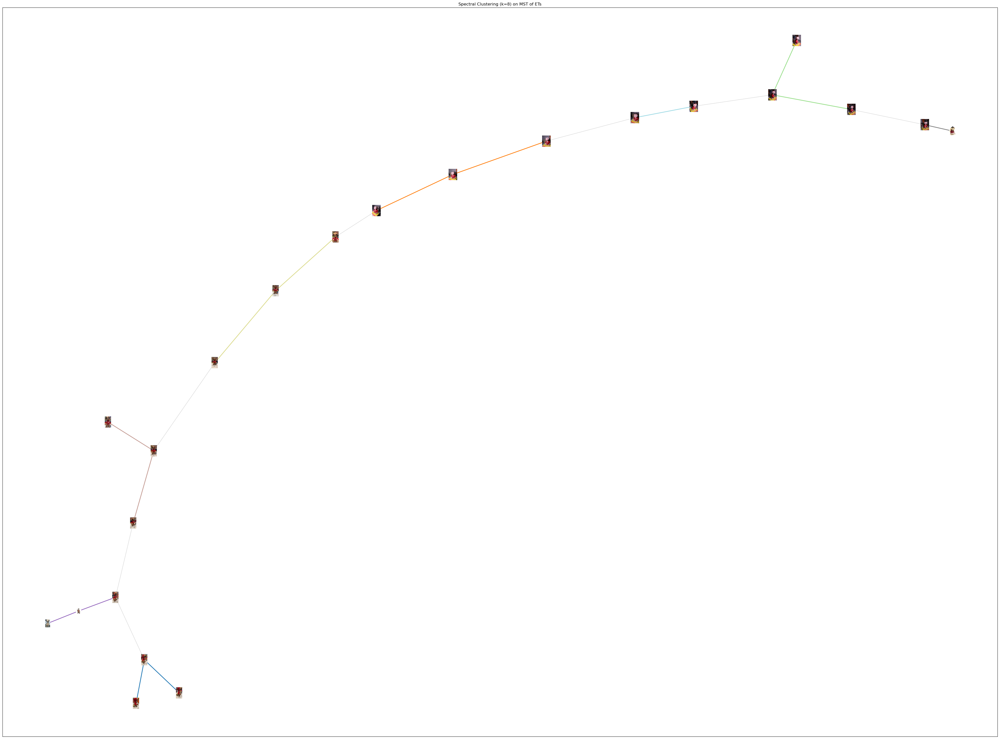

In [ ]:
# after computing mst, pos = get_mst(...)
clusters, outliers = cluster_by_spectral_clustering(
    mst,
    pos,
    train_image_paths,
    name="ETs",
    min_cluster_size=5,
    image_zoom=0.05
)


Detected 2 clusters and 3 outlier groups.


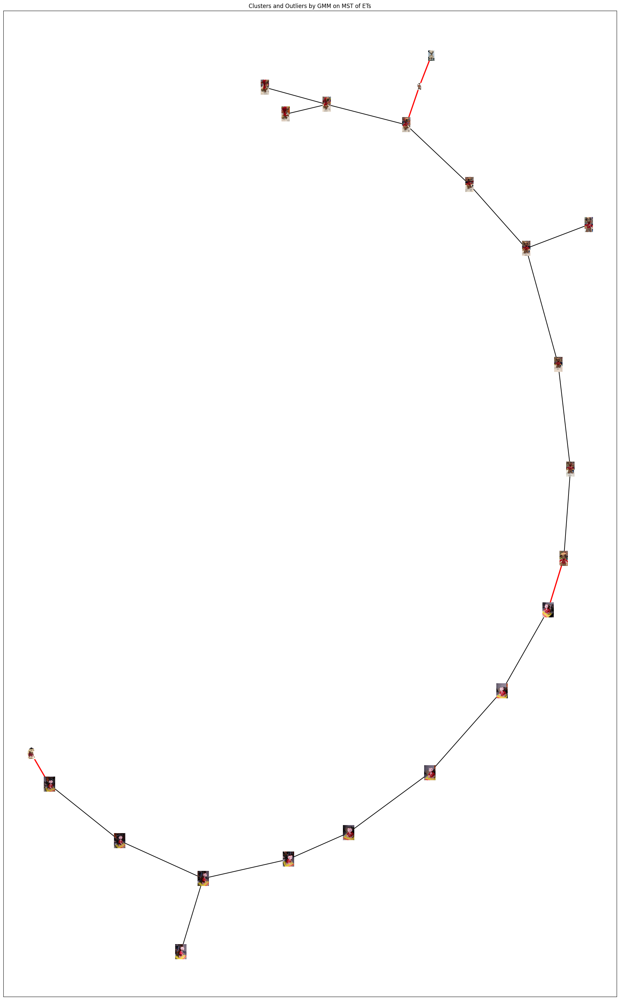

In [13]:
# After you have computed mst and pos:
clusters, outliers = cluster_by_GMM(
    mst,
    pos,
    train_image_paths,
    name="ETs",
    min_cluster_size=5,
    image_zoom=0.05
)


In [ ]:
clusters

[['another_et_another_et006.png',
  'another_et_another_et009.png',
  'another_et_another_et004.png',
  'another_et_another_et003.png',
  'another_et_another_et005.png',
  'another_et_another_et001.png',
  'another_et_another_et008.png',
  'another_et_another_et010.png',
  'another_et_another_et007.png',
  'another_et_another_et002.png'],
 ['et_et001.png',
  'et_et006.png',
  'et_et008.png',
  'et_et003.png',
  'et_et005.png',
  'et_et004.png',
  'et_et007.png',
  'et_et002.png',
  'et_et000.png']]

In [ ]:
outliers

[['outliers_out_et001.png'],
 ['outliers_out_et002.png'],
 ['outliers_out_et003.png']]

Loading features for imc2024_lizard_pond...
Loaded features for 214 images
Building similarity graph...
Starting similarity computation...
Processed pairs: 128/22791 (0.6%)
Processed pairs: 256/22791 (1.1%)
Processed pairs: 384/22791 (1.7%)
Processed pairs: 512/22791 (2.2%)
Processed pairs: 640/22791 (2.8%)
Processed pairs: 768/22791 (3.4%)
Processed pairs: 896/22791 (3.9%)
Processed pairs: 1024/22791 (4.5%)
Processed pairs: 1152/22791 (5.1%)
Processed pairs: 1280/22791 (5.6%)
Processed pairs: 1408/22791 (6.2%)
Processed pairs: 1536/22791 (6.7%)
Processed pairs: 1664/22791 (7.3%)
Processed pairs: 1792/22791 (7.9%)
Processed pairs: 1920/22791 (8.4%)
Processed pairs: 2048/22791 (9.0%)
Processed pairs: 2176/22791 (9.5%)
Processed pairs: 2304/22791 (10.1%)
Processed pairs: 2432/22791 (10.7%)
Processed pairs: 2560/22791 (11.2%)
Processed pairs: 2688/22791 (11.8%)
Processed pairs: 2816/22791 (12.4%)
Processed pairs: 2944/22791 (12.9%)
Processed pairs: 3072/22791 (13.5%)
Processed pairs: 3200

StopIteration: 

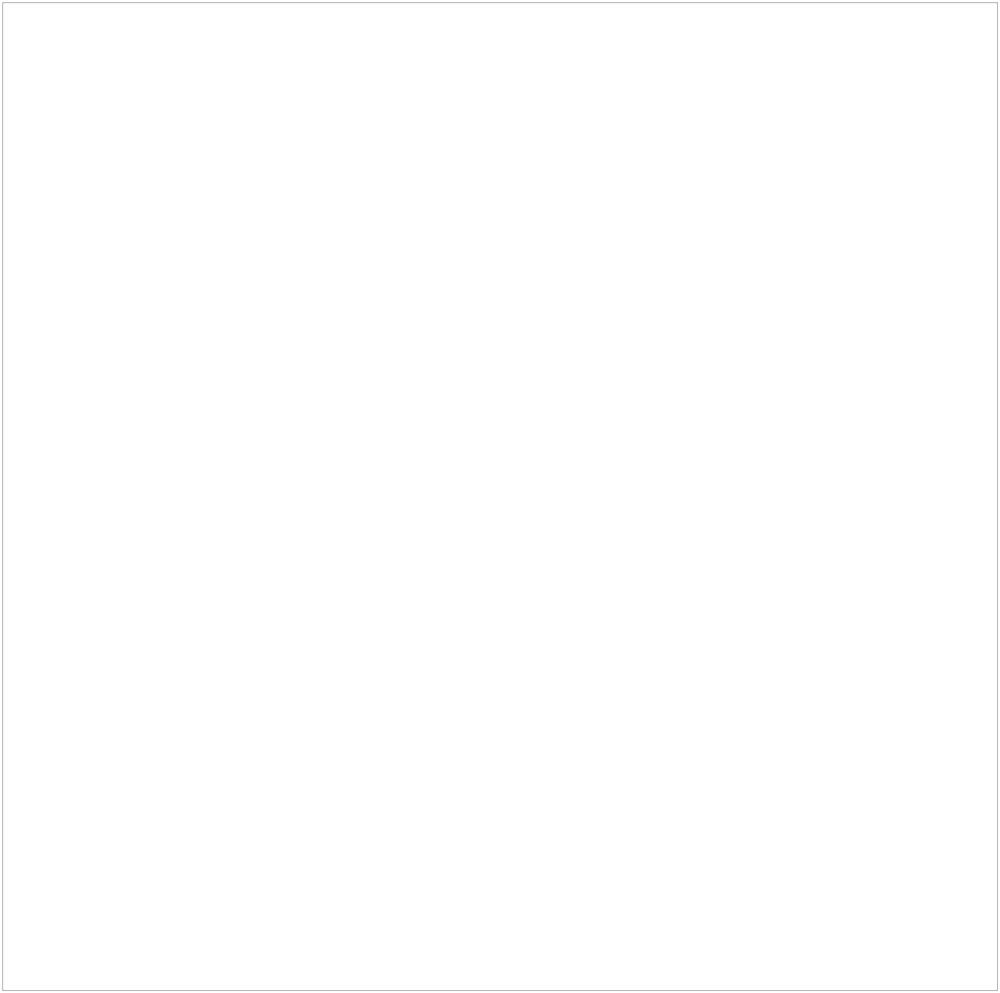

In [24]:
# k factor resimlerin dizilişini ayarlıyor
mst, pos = get_mst("imc2024_lizard_pond", train_image_paths=train_image_paths, k_factor=2.0, device = device, threshold=0.2, FEATURES_TYPE_FOR_LG=FEATURES_TYPE_FOR_LG, batch_size=128, figure_size=(50,50))


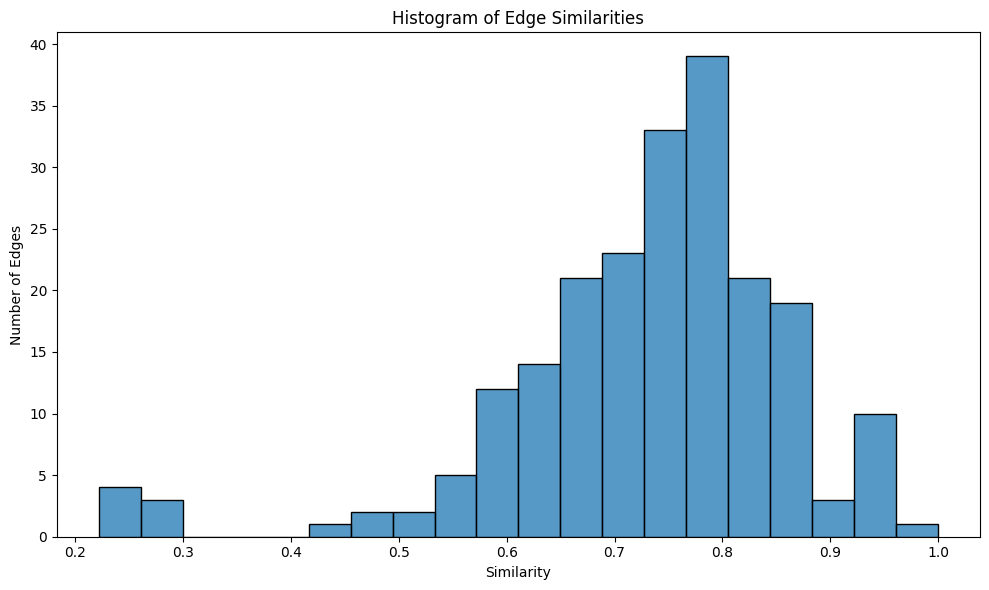

Removing edges with the 2 lowest distinct similarity values: {0.22181551976573938, 0.23041894353369763}
Found 1 clusters (size > 5):
  Cluster 1 (212 nodes): ['pond_01133.png', 'lizard_00512.png', 'lizard_00226.png', 'lizard_00618.png', 'lizard_00402.png', 'pond_00231.png', 'pond_00359.png', 'outliers_img_20230617_181901.png', 'pond_00456.png', 'pond_01131.png', 'lizard_00637.png', 'pond_00750.png', 'lizard_00571.png', 'pond_00086.png', 'outliers_img_20230617_181914.png', 'lizard_00203.png', 'lizard_00173.png', 'pond_00421.png', 'pond_00574.png', 'pond_00030.png', 'lizard_00066.png', 'pond_00022.png', 'outliers_img_20230617_181536.png', 'lizard_00192.png', 'pond_00969.png', 'lizard_00160.png', 'outliers_img_20230617_181850.png', 'pond_00011.png', 'lizard_00140.png', 'pond_01120.png', 'pond_00162.png', 'lizard_00075.png', 'pond_00920.png', 'pond_00007.png', 'lizard_00268.png', 'lizard_00613.png', 'pond_00864.png', 'pond_00300.png', 'lizard_00527.png', 'pond_00644.png', 'lizard_00716.png

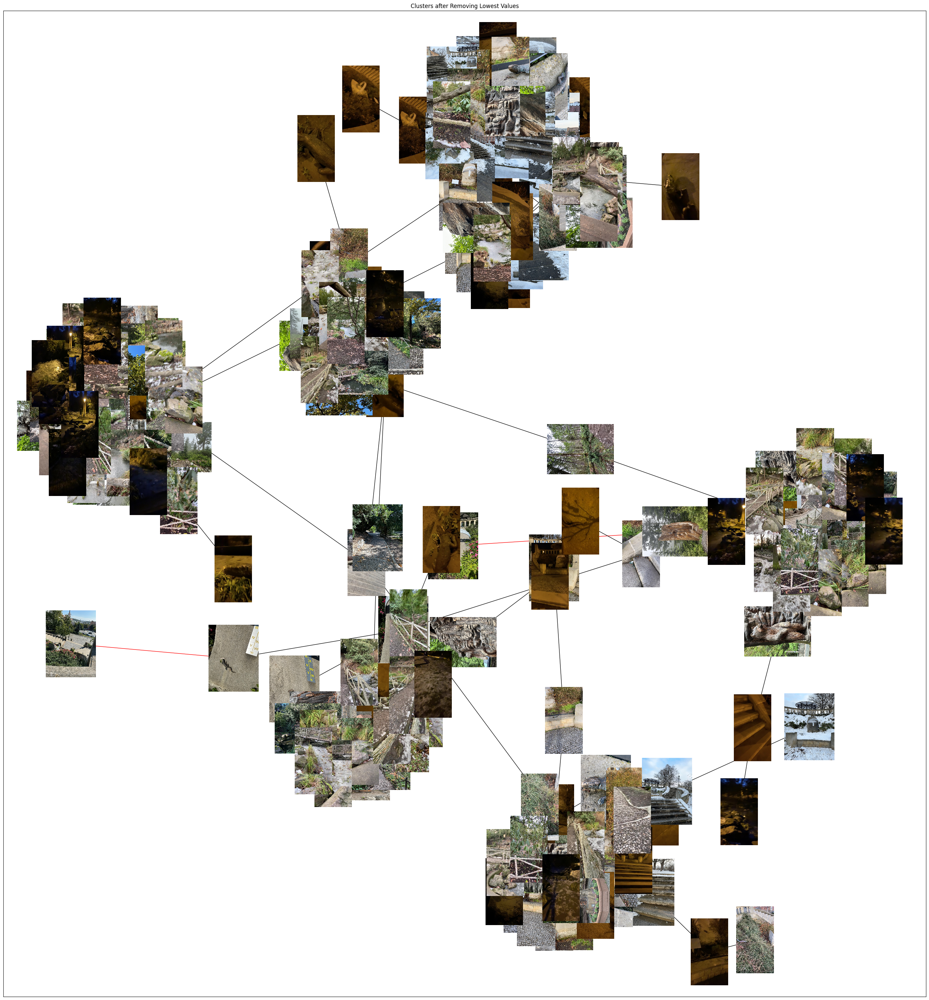

([['pond_01133.png',
   'lizard_00512.png',
   'lizard_00226.png',
   'lizard_00618.png',
   'lizard_00402.png',
   'pond_00231.png',
   'pond_00359.png',
   'outliers_img_20230617_181901.png',
   'pond_00456.png',
   'pond_01131.png',
   'lizard_00637.png',
   'pond_00750.png',
   'lizard_00571.png',
   'pond_00086.png',
   'outliers_img_20230617_181914.png',
   'lizard_00203.png',
   'lizard_00173.png',
   'pond_00421.png',
   'pond_00574.png',
   'pond_00030.png',
   'lizard_00066.png',
   'pond_00022.png',
   'outliers_img_20230617_181536.png',
   'lizard_00192.png',
   'pond_00969.png',
   'lizard_00160.png',
   'outliers_img_20230617_181850.png',
   'pond_00011.png',
   'lizard_00140.png',
   'pond_01120.png',
   'pond_00162.png',
   'lizard_00075.png',
   'pond_00920.png',
   'pond_00007.png',
   'lizard_00268.png',
   'lizard_00613.png',
   'pond_00864.png',
   'pond_00300.png',
   'lizard_00527.png',
   'pond_00644.png',
   'lizard_00716.png',
   'pond_00573.png',
   'pond_002

In [ ]:
# After you have computed mst and pos:
clusters, outliers = cluster_by_GMM(
    mst,
    pos,
    train_image_paths,
    name="imc2024_lizard_pond",
    min_cluster_size=10,
    image_zoom=0.05
)


In [ ]:
# k factor resimlerin dizilişini ayarlıyor # 25+ dk sürüyor wtf
mst, pos = get_mst("amy_gardens", train_image_paths=train_image_paths, k_factor=3.0, device = device, FEATURES_TYPE_FOR_LG=FEATURES_TYPE_FOR_LG)

KeyboardInterrupt: 